# Extract Data

In [2]:
# !tar -xf images.tgz

In [3]:
# !tar -xf lists.tgz

In [4]:
# mkdir bird

# Import required libraries

In [5]:
import os
import pathlib
import numpy as np
import tensorflow as tf
import warnings
warnings.filterwarnings("ignore")
from tensorflow import keras
from tensorflow.keras.layers.experimental import preprocessing
import matplotlib.pyplot as plt
import random
import cv2
from glob import glob
import shutil
from tensorflow.keras.models import Sequential
from tensorflow.keras import preprocessing
from tensorflow.keras import layers, models, preprocessing, regularizers
import itertools
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# Set-up GPU

In [133]:
!nvidia-smi

Thu Jul 18 22:52:13 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 556.12                 Driver Version: 556.12         CUDA Version: 12.5     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4060      WDDM  |   00000000:01:00.0  On |                  N/A |
| 98%   34C    P8             N/A /  138W |    7194MiB /   8188MiB |     22%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [6]:
physical_devices = tf.config.experimental.list_physical_devices('GPU')
# tf.config.experimental.set_memory_growth(physical_devices[0], True)
print(physical_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [7]:
tf.config.experimental.set_virtual_device_configuration(
    physical_devices[0],
    [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=1024*15)])

# Perform Exploratory Data Analysis

In [8]:
data_path = "bird/images"

In [9]:
for dirpath, dirnames, filenames in os.walk(data_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

There are 200 directories and 200 images in 'bird/images'.
There are 0 directories and 72 images in 'bird/images\001.Black_footed_Albatross'.
There are 0 directories and 52 images in 'bird/images\002.Laysan_Albatross'.
There are 0 directories and 52 images in 'bird/images\003.Sooty_Albatross'.
There are 0 directories and 70 images in 'bird/images\004.Groove_billed_Ani'.
There are 0 directories and 50 images in 'bird/images\005.Crested_Auklet'.
There are 0 directories and 56 images in 'bird/images\006.Least_Auklet'.
There are 0 directories and 66 images in 'bird/images\007.Parakeet_Auklet'.
There are 0 directories and 64 images in 'bird/images\008.Rhinoceros_Auklet'.
There are 0 directories and 52 images in 'bird/images\009.Brewer_Blackbird'.
There are 0 directories and 54 images in 'bird/images\010.Red_winged_Blackbird'.
There are 0 directories and 54 images in 'bird/images\011.Rusty_Blackbird'.
There are 0 directories and 56 images in 'bird/images\012.Yellow_headed_Blackbird'.
There a

## Plot few images

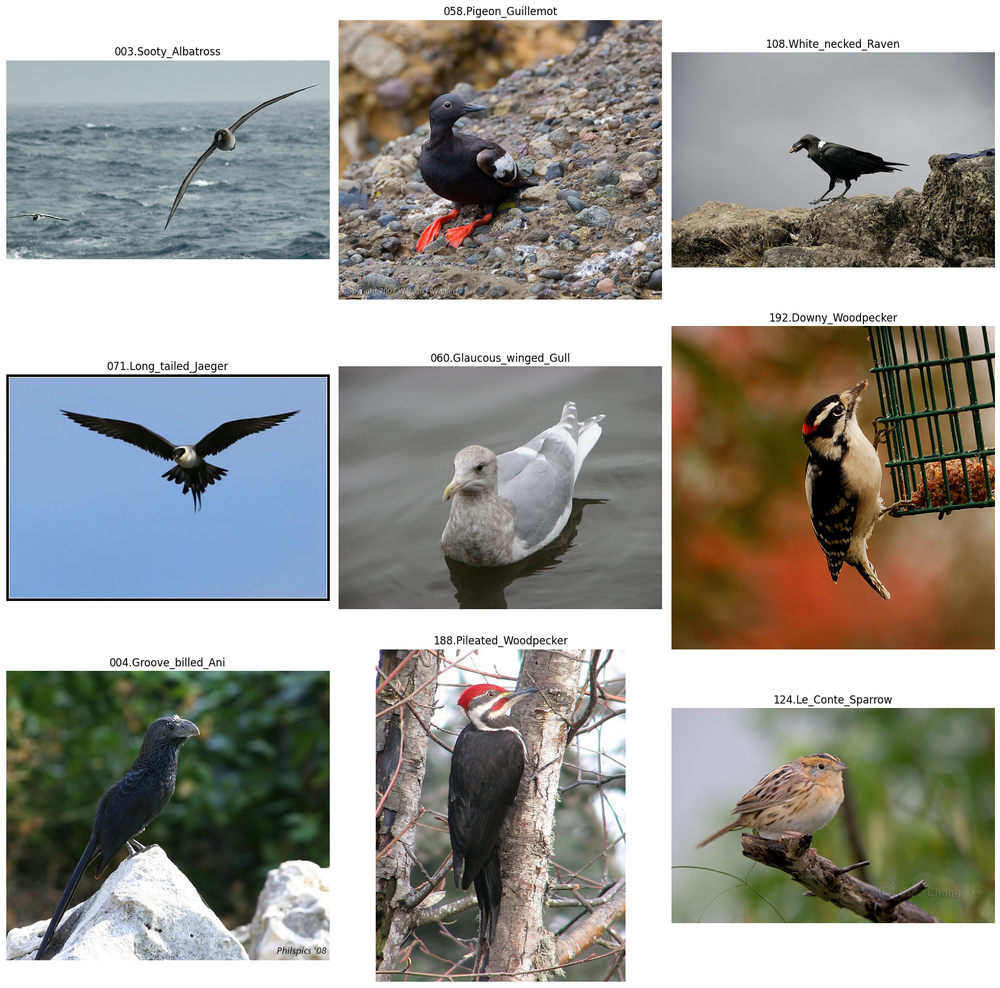

In [77]:
base_dir = 'bird'
data_path = os.path.join(base_dir, 'train')

class_dirs = glob(os.path.join(data_path, '*'))

random_classes = random.sample(class_dirs, 9)

plt.figure(figsize=(16, 16))

for i, class_dir in enumerate(random_classes):
    
    images = glob(os.path.join(class_dir, '*'))
    
    random_image = random.choice(images)
    
    image = cv2.imread(random_image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    plt.subplot(3, 3, i + 1)
    plt.imshow(image)
    plt.title(os.path.basename(class_dir))
    plt.axis('off')

plt.tight_layout()
plt.show()


## Create train and test data

In [10]:
base_dir = 'bird'
images_dir = os.path.join(base_dir, 'images')
lists_dir = os.path.join(base_dir, 'lists')
train_list_file = os.path.join(lists_dir, 'train.txt')
test_list_file = os.path.join(lists_dir, 'test.txt')


train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')


os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)


def copy_images(file_list, target_dir):
    with open(file_list, 'r') as f:
        for line in f:
            image_path = line.strip()
            
            class_folder, image_file = os.path.split(image_path)
            class_name = os.path.basename(class_folder)
           
            target_class_dir = os.path.join(target_dir, class_name)
            os.makedirs(target_class_dir, exist_ok=True)
            
            source = os.path.join(images_dir, image_path)
            destination = os.path.join(target_class_dir, image_file)
            shutil.copy(source, destination)


copy_images(train_list_file, train_dir)
copy_images(test_list_file, test_dir)

IMG_SIZE = (400, 400)

train_data = tf.keras.preprocessing.image_dataset_from_directory(train_dir,
                                                                label_mode="categorical",
                                                                image_size=IMG_SIZE,
                                                                seed = 32)

test_data = tf.keras.preprocessing.image_dataset_from_directory(test_dir,
                                                                label_mode="categorical",
                                                                image_size=IMG_SIZE,
                                                                shuffle=False)  

Found 3000 files belonging to 200 classes.
Found 3033 files belonging to 200 classes.


- The train-test split as given in the dataset is of 50-50% ratio.

## Check if data is balanced

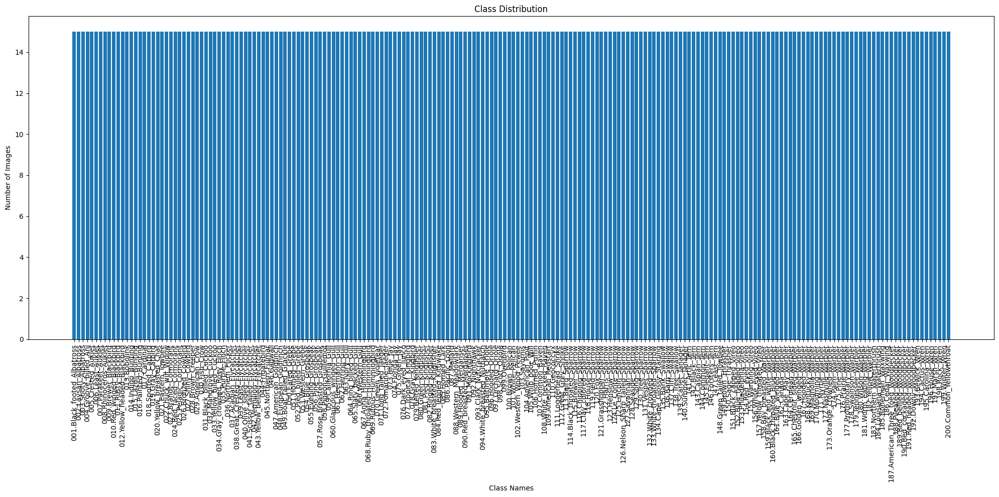

In [12]:
class_names = train_data.class_names
class_counts = []
for class_name in class_names:
    class_dir = pathlib.Path(train_dir) / class_name
    num_images = len(list(class_dir.glob('*')))
    class_counts.append(num_images)
    

sorted_data = sorted(zip(class_names, class_counts), key=lambda x: x[1], reverse=True)
class_names_sorted, class_counts_sorted = zip(*sorted_data)


plt.figure(figsize=(20, 10))
plt.bar(range(len(class_names_sorted)), class_counts_sorted, align='center')
plt.xlabel('Class Names')
plt.ylabel('Number of Images')
plt.title('Class Distribution')
plt.xticks(range(len(class_names_sorted)), class_names_sorted, rotation=90)
plt.tight_layout()
plt.show()

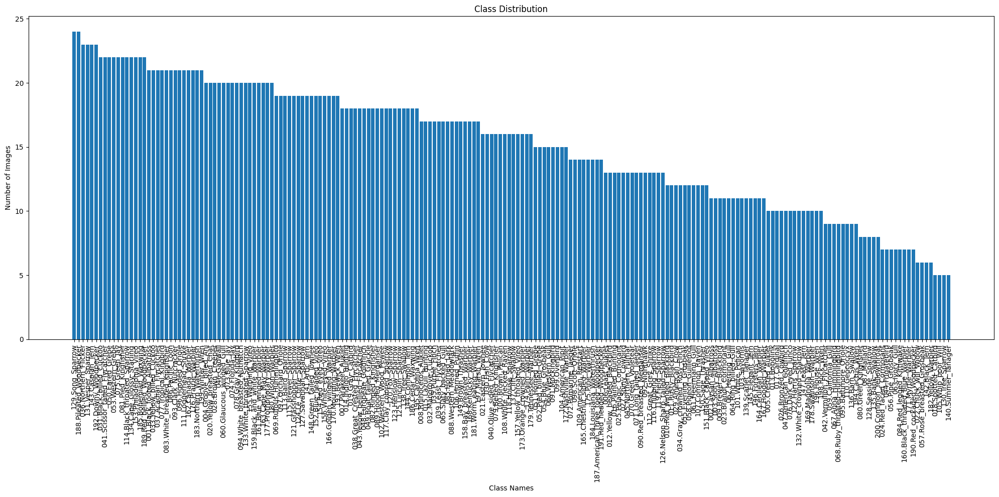

In [14]:
class_names = test_data.class_names
class_counts = []
for class_name in class_names:
    class_dir = pathlib.Path(test_dir) / class_name
    num_images = len(list(class_dir.glob('*')))
    class_counts.append(num_images)
    
sorted_data = sorted(zip(class_names, class_counts), key=lambda x: x[1], reverse=True)
class_names_sorted, class_counts_sorted = zip(*sorted_data)


plt.figure(figsize=(20, 10)) 
plt.bar(range(len(class_names_sorted)), class_counts_sorted, align='center')
plt.xlabel('Class Names')
plt.ylabel('Number of Images')
plt.title('Class Distribution')
plt.xticks(range(len(class_names_sorted)), class_names_sorted, rotation=90)
plt.tight_layout()
plt.show()

# Model Training

## Data Augmentation

In [17]:
data_augmentation = Sequential([
  # layers.RandomCrop(375, 375),
  layers.RandomFlip("horizontal"),
  # layers.RandomFlip("vertical"),
  layers.RandomRotation(0.2),
  layers.RandomZoom(0.2),
  # layers.RandomHeight(0.2),
  # layers.RandomWidth(0.2),
  # layers.RandomContrast(0.2),
  # layers.RandomBrightness(0.2),
  # layers.RandomTranslation(0.2, 0.2),
  layers.Rescaling(1./255)
], name ="data_augmentation")

## Model Building with feature extraction

In [18]:
base_model = tf.keras.applications.ResNet152V2(include_top=False)
base_model.trainable = False


inputs = layers.Input(shape=(400, 400, 3), name="input_layer")
x = data_augmentation(inputs)
x = base_model(x, training=False) 
x = layers.GlobalAveragePooling2D(name="global_average_pooling")(x)
x = layers.BatchNormalization()(x)
x = layers.Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.Dropout(0.5)(x)
x = layers.BatchNormalization()(x)
outputs = layers.Dense(len(train_data.class_names), activation="softmax", name="output_layer")(x)
model = tf.keras.Model(inputs, outputs)

In [19]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 400, 400, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, 400, 400, 3)      0         
 al)                                                             
                                                                 
 resnet152v2 (Functional)    (None, None, None, 2048)  58331648  
                                                                 
 global_average_pooling (Glo  (None, 2048)             0         
 balAveragePooling2D)                                            
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                             

# Model compilation and fitting

In [20]:
# model.compile(
#     optimizer=RMSprop(lr=0.0001), 
#     loss='binary_crossentropy', 
#     metrics=['accuracy']
# )
# training_steps = Data_train.samples//Data_train.batch_size
# validation_steps=Data_test.samples//Data_test.batch_size
# inceptionv3_history=model.fit_generator(Data_train,epochs=2,steps_per_epoch=training_steps,validation_data=Data_test,validation_steps=validation_steps)

# model.compile(loss="categorical_crossentropy",
#               optimizer= tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9),
#               metrics=["accuracy"])

# lr_scheduler = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 0.01 * pow(0.1, epoch // 7))


# history_model = model.fit(train_data,
#                            epochs=20, 
#                            validation_data=test_data,
#                            validation_steps=int(0.15 * len(test_data)),
#                            callbacks=[lr_scheduler, tf.keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True)]) 

model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.001),
              metrics=['accuracy'])

lr_scheduler = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 0.001 * pow(0.1, epoch // 7))

history_model = model.fit(train_data,
                          epochs=20,
                          validation_data=test_data,
                          validation_steps=int(0.15 * len(test_data)),
                          callbacks=[lr_scheduler, tf.keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True)])

Epoch 1/20
94/94 [==============================] - 60s 553ms/step - loss: 5.5258 - accuracy: 0.0797 - val_loss: 4.7380 - val_accuracy: 0.3460 - lr: 0.0010
Epoch 2/20
94/94 [==============================] - 50s 536ms/step - loss: 3.9786 - accuracy: 0.3070 - val_loss: 3.8547 - val_accuracy: 0.4710 - lr: 0.0010
Epoch 3/20
94/94 [==============================] - 50s 535ms/step - loss: 3.3122 - accuracy: 0.4373 - val_loss: 3.2505 - val_accuracy: 0.5402 - lr: 0.0010
Epoch 4/20
94/94 [==============================] - 50s 535ms/step - loss: 2.8833 - accuracy: 0.5260 - val_loss: 2.8920 - val_accuracy: 0.5513 - lr: 0.0010
Epoch 5/20
94/94 [==============================] - 50s 536ms/step - loss: 2.5782 - accuracy: 0.5920 - val_loss: 2.6529 - val_accuracy: 0.5759 - lr: 0.0010
Epoch 6/20
94/94 [==============================] - 50s 534ms/step - loss: 2.3642 - accuracy: 0.6423 - val_loss: 2.5342 - val_accuracy: 0.5982 - lr: 0.0010
Epoch 7/20
94/94 [==============================] - 50s 536ms/st

## Model Evaluation

In [21]:
results_feature_extraction_model = model.evaluate(test_data)
results_feature_extraction_model

95/95 [==============================] - 35s 372ms/step - loss: 2.4461 - accuracy: 0.5826


[2.4460902214050293, 0.5825914740562439]

## Plot Model Performance

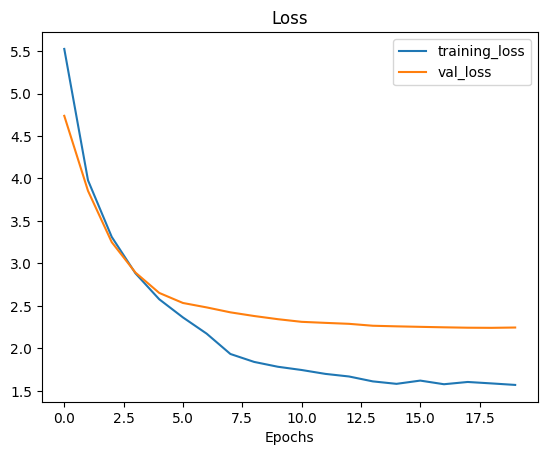

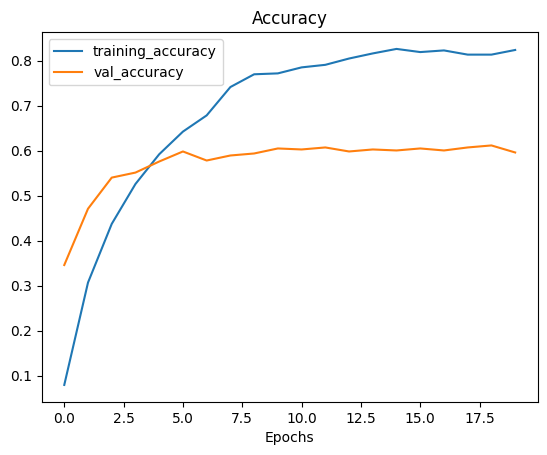

In [138]:
import matplotlib.pyplot as plt

def plot_loss_curves(history, loss_plot_path='loss_plot.png', accuracy_plot_path='accuracy_plot.png'):
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']

    epochs = range(len(history.history['loss']))

    # Plot loss
    plt.figure()
    plt.plot(epochs, loss, label='training_loss')
    plt.plot(epochs, val_loss, label='val_loss')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.legend()
    plt.savefig(loss_plot_path)

    plt.figure()
    plt.plot(epochs, accuracy, label='training_accuracy')
    plt.plot(epochs, val_accuracy, label='val_accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.legend()
    plt.savefig(accuracy_plot_path)

plot_loss_curves(history_model, 'feature_extraction_loss_plot.png', 'feature_exraction_accuracy_plot.png')

## Model Building with fine-tuning

In [24]:
base_model.trainable = True

for layer in base_model.layers[:-20]:
  layer.trainable = False

In [25]:
initial_learning_rate = 1e-4
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=1000,
    decay_rate=0.6,
    staircase=True)

optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
# optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, decay=1e-5)

model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

# lr_scheduler = tf.keras.callbacks.LearningRateScheduler(lambda epoch: initial_learning_rate * pow(0.6, epoch // 7))

# model.compile(loss='categorical_crossentropy',
#               optimizer=tf.keras.optimizers.Adam(1e-4),
#               metrics=['accuracy'])

In [26]:
for layer in model.layers:
  print(layer.name, layer.trainable)

input_layer True
data_augmentation True
resnet152v2 True
global_average_pooling True
batch_normalization True
dense True
dropout True
batch_normalization_1 True
output_layer True


In [30]:
# fine_tune_epochs = 50 

# history_model_fine_tune = model.fit(train_data,
#                                     epochs=fine_tune_epochs,
#                                     validation_data=test_data,
#                                     validation_steps=int(0.15 * len(test_data)),
#                                     initial_epoch=history_model.epoch[-1])


# callbacks = [
#     tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True),
#     tf.keras.callbacks.ReduceLROnPlateau(factor=0.5, patience=5, min_lr=1e-6)
# ]


# fine_tune_epochs = 50

# history_model_fine_tune = model.fit(train_data,
#                                     epochs=fine_tune_epochs,
#                                     validation_data=test_data,
#                                     validation_steps=int(0.15 * len(test_data)),
#                                     initial_epoch=history_model.epoch[-1],
#                                     callbacks=callbacks)


fine_tune_epochs = 60 

history_model_fine_tune = model.fit(train_data,
                                    epochs=fine_tune_epochs,
                                    validation_data=test_data,
                                    validation_steps=int(0.15 * len(test_data)),
                                    initial_epoch=history_model.epoch[-1],
                                    callbacks=[tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)])

Epoch 20/60
94/94 [==============================] - 149s 2s/step - loss: 1.3858 - accuracy: 0.8523 - val_loss: 2.1504 - val_accuracy: 0.6205
Epoch 21/60
94/94 [==============================] - 142s 2s/step - loss: 1.3307 - accuracy: 0.8707 - val_loss: 2.2315 - val_accuracy: 0.6317
Epoch 22/60
94/94 [==============================] - 143s 2s/step - loss: 1.2360 - accuracy: 0.8933 - val_loss: 2.0806 - val_accuracy: 0.6518
Epoch 23/60
94/94 [==============================] - 138s 1s/step - loss: 1.1563 - accuracy: 0.9110 - val_loss: 2.0372 - val_accuracy: 0.6362
Epoch 24/60
94/94 [==============================] - 145s 2s/step - loss: 1.1175 - accuracy: 0.9160 - val_loss: 1.9826 - val_accuracy: 0.6585
Epoch 25/60
94/94 [==============================] - 140s 1s/step - loss: 1.0761 - accuracy: 0.9240 - val_loss: 1.8708 - val_accuracy: 0.7009
Epoch 26/60
94/94 [==============================] - 136s 1s/step - loss: 0.9842 - accuracy: 0.9407 - val_loss: 1.8964 - val_accuracy: 0.6830
Epoch 

In [31]:
results_fine_tune = model.evaluate(test_data)
results_fine_tune

95/95 [==============================] - 163s 2s/step - loss: 1.8526 - accuracy: 0.6653


[1.852630853652954, 0.6653478145599365]

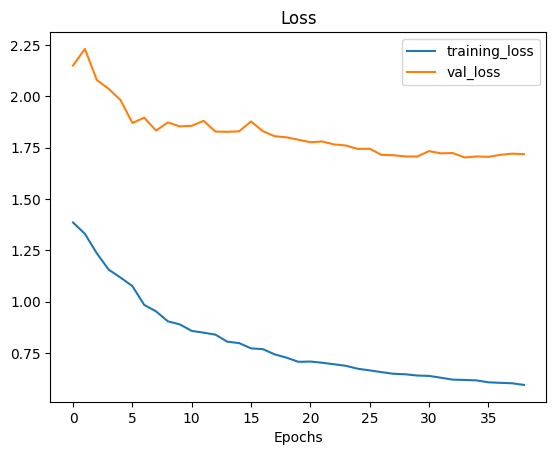

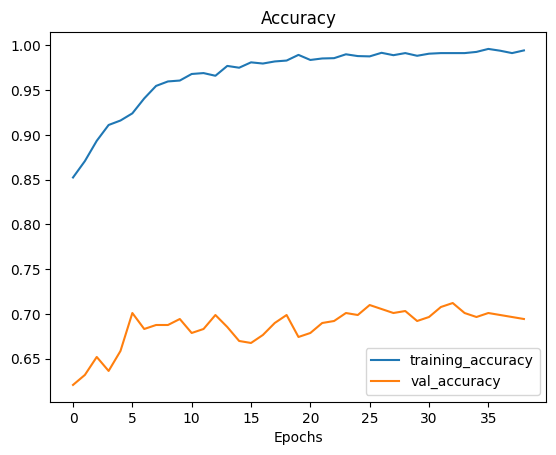

In [139]:
plot_loss_curves(history_model_fine_tune, 'fine_tune_loss_plot.png', 'fine_tune_accuracy_plot.png')

## Saving weights of trained model for later use

In [33]:
model.save('model_weights_1.h5')

In [106]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 400, 400, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, 400, 400, 3)      0         
 al)                                                             
                                                                 
 resnet152v2 (Functional)    (None, None, None, 2048)  58331648  
                                                                 
 global_average_pooling (Glo  (None, 2048)             0         
 balAveragePooling2D)                                            
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                             

In [108]:
model.load_weights('model_weights_1.h5')

In [109]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 400, 400, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, 400, 400, 3)      0         
 al)                                                             
                                                                 
 resnet152v2 (Functional)    (None, None, None, 2048)  58331648  
                                                                 
 global_average_pooling (Glo  (None, 2048)             0         
 balAveragePooling2D)                                            
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                             

# Evaluating Model Performance 

In [111]:
test_loss, test_accuracy = model.evaluate(test_data)

predictions = model.predict(test_data)
predicted_classes = np.argmax(predictions, axis=1)

95/95 [==============================] - 976s 10s/step


In [135]:
true_classes = np.concatenate([y for x, y in test_data], axis=0)
true_classes = np.argmax(true_classes, axis=1)  # Convert one-hot encoded labels to integers

class_names = test_data.class_names

## Testing model on random images

In [123]:
def load_and_prep_image(filename, img_shape=500, scale=True):
    
  img = tf.io.read_file(filename)
  img = tf.image.decode_jpeg(img)
  img = tf.image.resize(img, [img_shape, img_shape])
  if scale:
    return img/255.
  else:
    return img

1/1 [==============================] - 0s 25ms/step


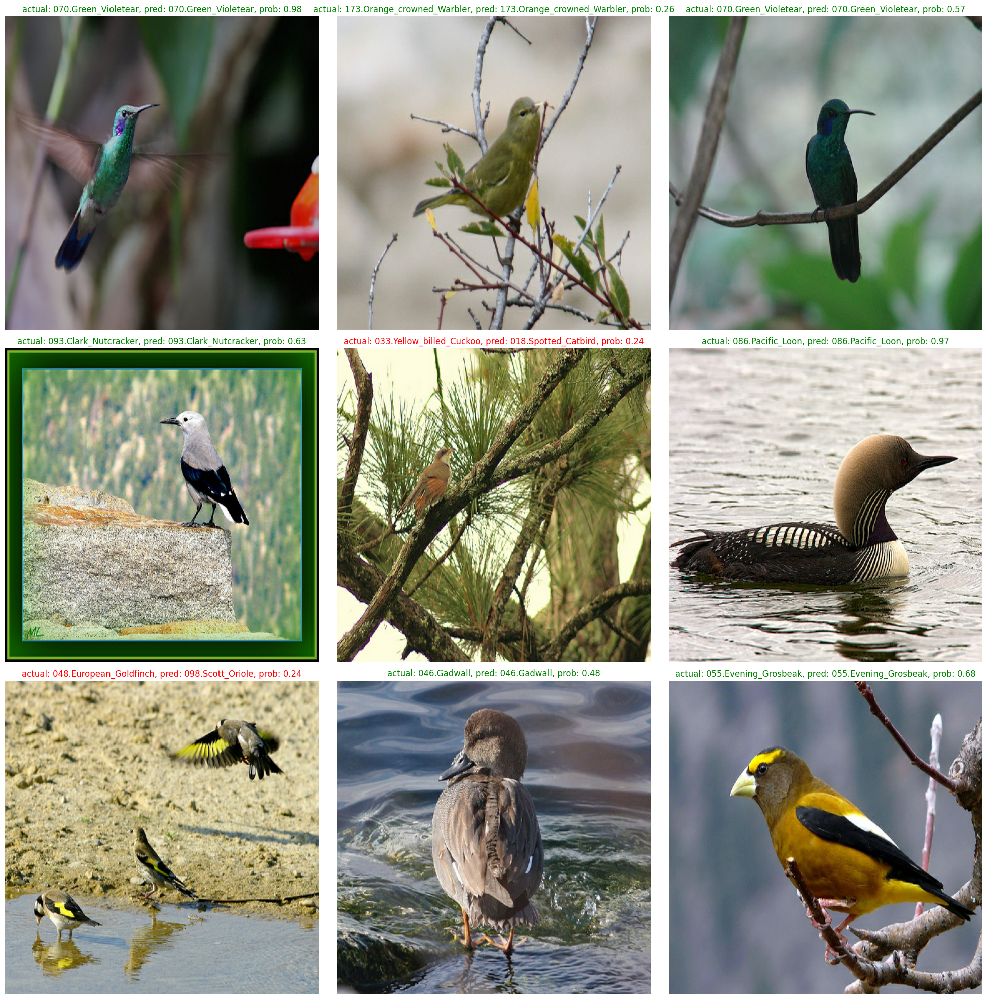

In [131]:
def plot_random_images(model, test_dir, class_names, num_images=9, figsize=(20, 20), save_path="random_image_predictions.png"):
    
    plt.figure(figsize=figsize)
    for i in range(num_images):
        
        class_name = random.choice(class_names)
        filename = random.choice(os.listdir(os.path.join(test_dir, class_name)))
        filepath = os.path.join(test_dir, class_name, filename)

        img = load_and_prep_image(filepath, scale=False)
        pred_prob = model.predict(tf.expand_dims(img, axis=0))
        pred_class = class_names[pred_prob.argmax()] 

        plt.subplot(int(num_images**0.5), int(num_images**0.5), i+1)
        plt.imshow(img / 255.0)
        title_color = "g" if class_name == pred_class else "r" 
        plt.title(f"actual: {class_name}, pred: {pred_class}, prob: {pred_prob.max():.2f}", c=title_color)
        plt.axis(False)

    plt.tight_layout()
    plt.savefig(save_path)
    plt.show()

plot_random_images(model, test_dir, class_names, save_path = "random_image_predictions_1.png")


1/1 [==============================] - 0s 25ms/step


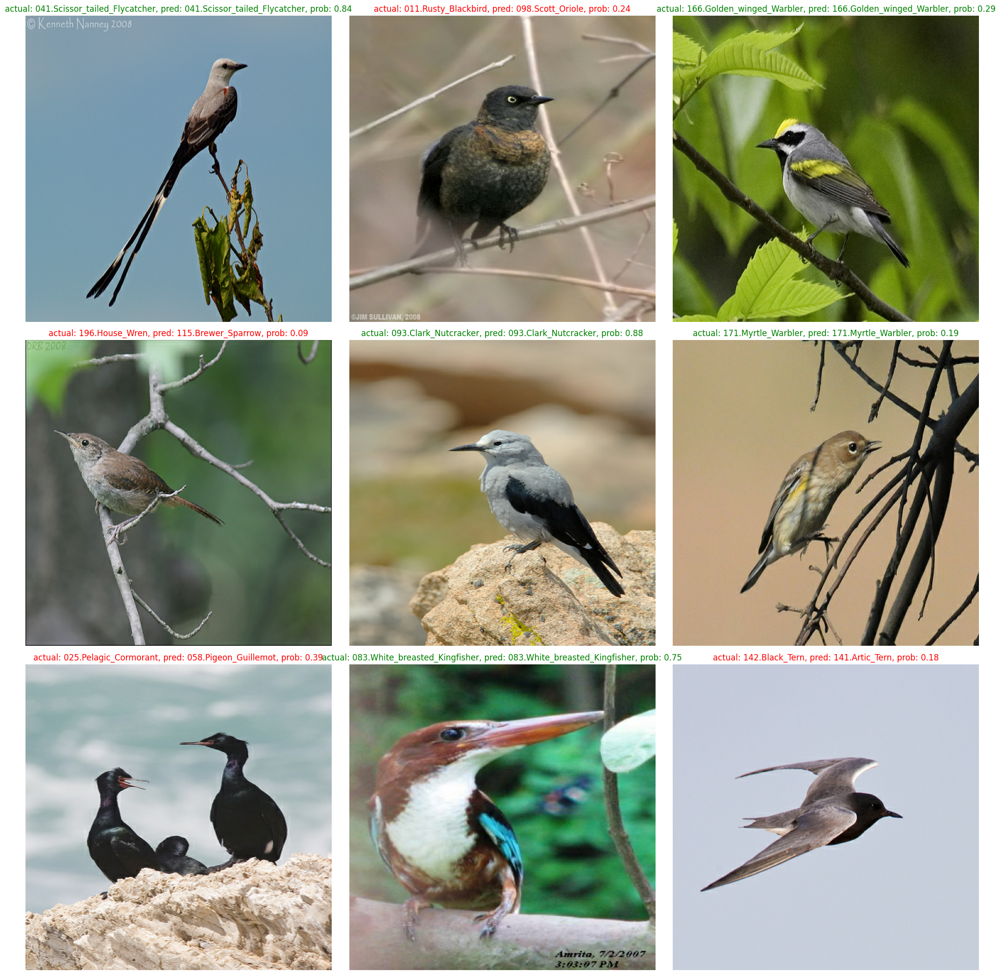

In [132]:
plot_random_images(model, test_dir, class_names, save_path = "random_image_predictions_2.png")

## Classification Report

In [35]:
print("Classification Report:")
print(classification_report(true_classes, predicted_classes, target_names=class_names))

Classification Report:
                                    precision    recall  f1-score   support

        001.Black_footed_Albatross       0.85      0.81      0.83        21
              002.Laysan_Albatross       0.82      0.82      0.82        11
               003.Sooty_Albatross       0.54      0.64      0.58        11
             004.Groove_billed_Ani       0.94      0.80      0.86        20
                005.Crested_Auklet       0.67      0.80      0.73        10
                  006.Least_Auklet       0.83      0.77      0.80        13
               007.Parakeet_Auklet       0.84      0.89      0.86        18
             008.Rhinoceros_Auklet       0.67      0.71      0.69        17
              009.Brewer_Blackbird       0.29      0.36      0.32        11
          010.Red_winged_Blackbird       1.00      0.67      0.80        12
               011.Rusty_Blackbird       0.60      0.25      0.35        12
       012.Yellow_headed_Blackbird       1.00      0.85      0.9

In [47]:
classification_report_dict = classification_report(true_classes, predicted_classes, output_dict=True)
classification_report_dict

{'0': {'precision': 0.85,
  'recall': 0.8095238095238095,
  'f1-score': 0.8292682926829268,
  'support': 21.0},
 '1': {'precision': 0.8181818181818182,
  'recall': 0.8181818181818182,
  'f1-score': 0.8181818181818182,
  'support': 11.0},
 '2': {'precision': 0.5384615384615384,
  'recall': 0.6363636363636364,
  'f1-score': 0.5833333333333334,
  'support': 11.0},
 '3': {'precision': 0.9411764705882353,
  'recall': 0.8,
  'f1-score': 0.8648648648648649,
  'support': 20.0},
 '4': {'precision': 0.6666666666666666,
  'recall': 0.8,
  'f1-score': 0.7272727272727273,
  'support': 10.0},
 '5': {'precision': 0.8333333333333334,
  'recall': 0.7692307692307693,
  'f1-score': 0.8,
  'support': 13.0},
 '6': {'precision': 0.8421052631578947,
  'recall': 0.8888888888888888,
  'f1-score': 0.8648648648648649,
  'support': 18.0},
 '7': {'precision': 0.6666666666666666,
  'recall': 0.7058823529411765,
  'f1-score': 0.6857142857142857,
  'support': 17.0},
 '8': {'precision': 0.2857142857142857,
  'recall':

## Plotting graph of f1-score for different classes

In [48]:
class_f1_scores = {}

for k, v in classification_report_dict.items():
  if k == "accuracy":
    break
  else:
    
    class_f1_scores[class_names[int(k)]] = v["f1-score"]
class_f1_scores

{'001.Black_footed_Albatross': 0.8292682926829268,
 '002.Laysan_Albatross': 0.8181818181818182,
 '003.Sooty_Albatross': 0.5833333333333334,
 '004.Groove_billed_Ani': 0.8648648648648649,
 '005.Crested_Auklet': 0.7272727272727273,
 '006.Least_Auklet': 0.8,
 '007.Parakeet_Auklet': 0.8648648648648649,
 '008.Rhinoceros_Auklet': 0.6857142857142857,
 '009.Brewer_Blackbird': 0.32,
 '010.Red_winged_Blackbird': 0.8,
 '011.Rusty_Blackbird': 0.35294117647058826,
 '012.Yellow_headed_Blackbird': 0.9166666666666666,
 '013.Bobolink': 0.8695652173913043,
 '014.Indigo_Bunting': 0.7777777777777778,
 '015.Lazuli_Bunting': 0.7878787878787878,
 '016.Painted_Bunting': 0.96,
 '017.Cardinal': 0.7058823529411765,
 '018.Spotted_Catbird': 0.7692307692307693,
 '019.Gray_Catbird': 0.8484848484848485,
 '020.Yellow_breasted_Chat': 0.95,
 '021.Eastern_Towhee': 0.875,
 '022.Chuck_will_Widow': 0.42857142857142855,
 '023.Brandt_Cormorant': 0.6666666666666666,
 '024.Red_faced_Cormorant': 0.625,
 '025.Pelagic_Cormorant': 0

In [49]:
f1_scores = pd.DataFrame({"class_name": list(class_f1_scores.keys()),
                          "f1-score": list(class_f1_scores.values())}).sort_values("f1-score", ascending=False)
f1_scores.head()
     

,class_name,f1-score
69,070.Green_Violetear,1.000000
79,080.Green_Kingfisher,1.000000
74,075.Green_Jay,0.976744
107,108.White_necked_Raven,0.969697
15,016.Painted_Bunting,0.960000


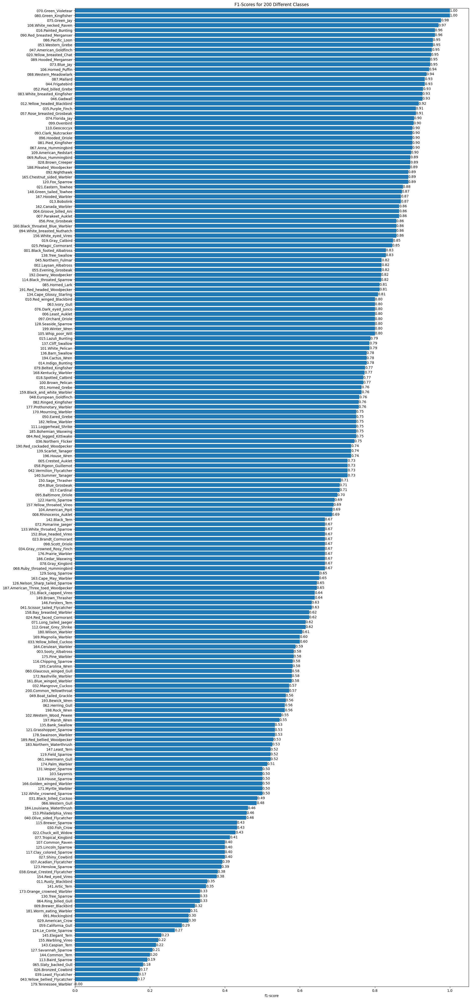

In [140]:
fig, ax = plt.subplots(figsize=(20, 50))
scores = ax.barh(range(len(f1_scores)), f1_scores["f1-score"].values)
ax.set_yticks(range(len(f1_scores)))
ax.set_yticklabels(list(f1_scores["class_name"]))
ax.set_xlabel("f1-score")
ax.set_title("F1-Scores for 200 Different Classes")
ax.set_ylim([-0.5, len(f1_scores["class_name"]) - 0.5])
ax.invert_yaxis(); 


bar_spacing = 0.01

def autolabel(rects):
    """
    Attach a text label above each bar displaying its height (value).
    """
    for rect in rects:
        width = rect.get_width()
        ax.text(rect.get_x() + rect.get_width() + bar_spacing,  # Adjusted position
                rect.get_y() + rect.get_height()/2.,
                f"{width:.2f}",
                ha='center', va='center', fontsize=10, color='black')

autolabel(scores)

plt.savefig('f1_scores_plot.png', dpi=300)
plt.show()

# Plotting Confusion Matrix

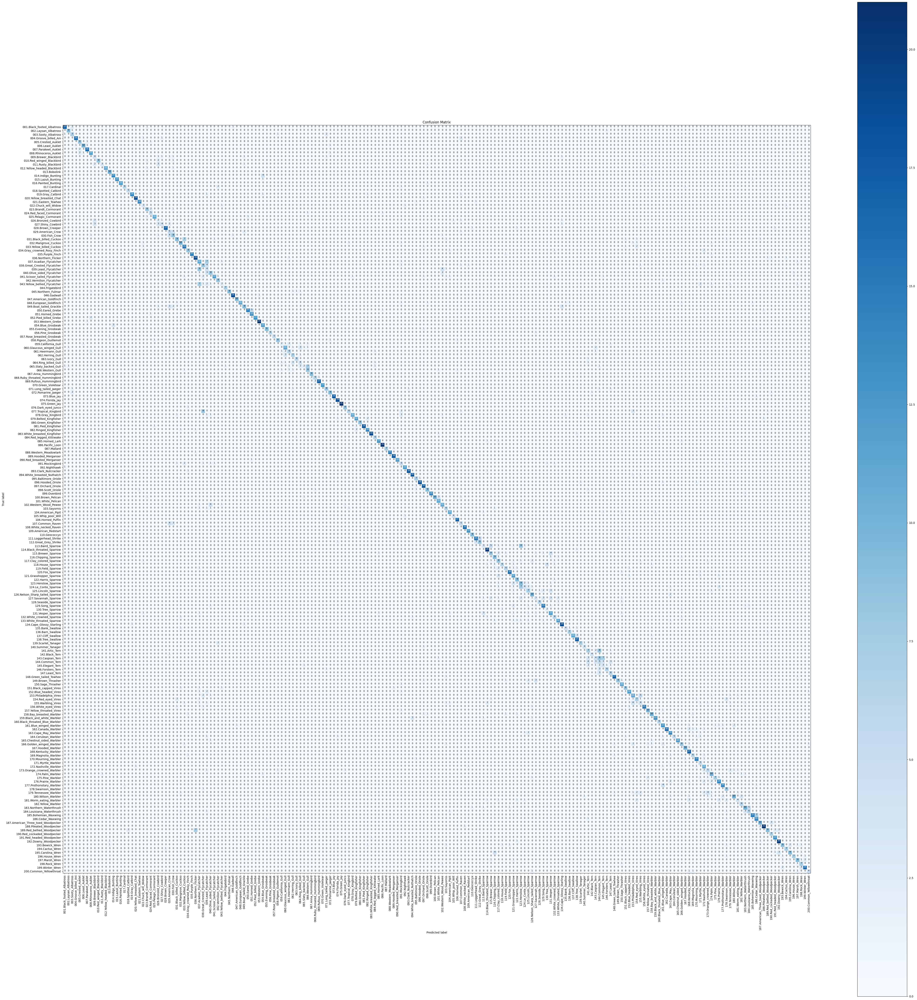

In [72]:
def make_confusion_matrix(y_true, y_pred, classes=None, figsize=(12, 10), text_size=12, norm=False, savefig=False):  
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis]
    n_classes = cm.shape[0]

    fig, ax = plt.subplots(figsize=figsize)
    cax = ax.matshow(cm, cmap=plt.cm.Blues)
    fig.colorbar(cax)

    if classes:
        labels = classes
    else:
        labels = np.arange(cm.shape[0])
    
    ax.set(title="Confusion Matrix",
           xlabel="Predicted label",
           ylabel="True label")

    ax.set_xticks(np.arange(n_classes))
    ax.set_yticks(np.arange(n_classes))
    
    ax.set_xticklabels(labels, rotation=90)
    ax.set_yticklabels(labels)

    ax.xaxis.set_label_position("bottom")
    ax.xaxis.tick_bottom()

    threshold = (cm.max() + cm.min()) / 2.

    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if norm:
            plt.text(j, i, f"{cm[i, j]} ({cm_norm[i, j]*100:.1f}%)",
                    horizontalalignment="center",
                    color="white" if cm[i, j] > threshold else "black",
                    size=text_size)
        else:
            plt.text(j, i, f"{cm[i, j]}",
                    horizontalalignment="center",
                    color="white" if cm[i, j] > threshold else "black",
                    size=text_size)

    if savefig:
        fig.savefig("confusion_matrix.png")

    plt.tight_layout()
    plt.show()

make_confusion_matrix(true_classes, predicted_classes, classes=class_names, figsize=(50, 50), text_size=8, norm=False, savefig=True)
